In [44]:
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import roc_curve, roc_auc_score
from xgboost import XGBClassifier
from sklearn.metrics import classification_report
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import RandomizedSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.utils.class_weight import compute_class_weight
import shap



df = pd.read_csv('loan_data.csv')


In [11]:
df

,person_age,person_gender,person_education,person_income,person_emp_exp,person_home_ownership,loan_amnt,loan_intent,cb_person_cred_hist_length,previous_loan_defaults_on_file,loan_status,loan_to_income_ratio,log_income,income_per_year_of_exp,is_young
0,22.0,female,Master,71948.0,0.1,RENT,35000.0,PERSONAL,3.0,No,1,0.486456,11.183713,719480.000000,1
1,21.0,female,High School,12282.0,0.1,OWN,1000.0,EDUCATION,2.0,Yes,0,0.081413,9.415971,122820.000000,1
2,25.0,female,High School,12438.0,3.0,MORTGAGE,5500.0,MEDICAL,3.0,No,1,0.442158,9.428592,4146.000000,0
3,23.0,female,Bachelor,79753.0,0.1,RENT,35000.0,MEDICAL,2.0,No,1,0.438849,11.286702,797530.000000,1
4,24.0,male,Master,66135.0,1.0,RENT,35000.0,MEDICAL,4.0,No,1,0.529213,11.099469,66135.000000,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44995,27.0,male,Associate,47971.0,6.0,RENT,15000.0,MEDICAL,3.0,No,1,0.312682,10.778373,7995.166667,0
44996,37.0,female,Associate,65800.0,17.0,RENT,9000.0,HOMEIMPROVEMENT,11.0,No,1,0.136776,11.094390,3870.588235,0
44997,33.0,male,Associate,56942.0,7.0,RENT,2771.0,DEBTCONSOLIDATION,10.0,No,1,0.048663,10.949806,8134.571429,0
44998,29.0,male,Bachelor,33164.0,4.0,RENT,12000.0,EDUCATION,6.0,No,1,0.361827,10.409250,8291.000000,0


In [4]:
df.columns


Index(['person_age', 'person_gender', 'person_education', 'person_income',
       'person_emp_exp', 'person_home_ownership', 'loan_amnt', 'loan_intent',
       'loan_int_rate', 'loan_percent_income', 'cb_person_cred_hist_length',
       'credit_score', 'previous_loan_defaults_on_file', 'loan_status'],
      dtype='object')

In [4]:
df['person_education'].unique()

array(['Master', 'High School', 'Bachelor', 'Associate', 'Doctorate'],
      dtype=object)

In [5]:
df.describe()

,person_age,person_income,person_emp_exp,loan_amnt,loan_int_rate,loan_percent_income,cb_person_cred_hist_length,credit_score,loan_status
count,45000.000000,4.500000e+04,45000.000000,45000.000000,45000.000000,45000.000000,45000.000000,45000.000000,45000.000000
mean,27.764178,8.031905e+04,5.410333,9583.157556,11.006606,0.139725,5.867489,632.608756,0.222222
std,6.045108,8.042250e+04,6.063532,6314.886691,2.978808,0.087212,3.879702,50.435865,0.415744
min,20.000000,8.000000e+03,0.000000,500.000000,5.420000,0.000000,2.000000,390.000000,0.000000
25%,24.000000,4.720400e+04,1.000000,5000.000000,8.590000,0.070000,3.000000,601.000000,0.000000
50%,26.000000,6.704800e+04,4.000000,8000.000000,11.010000,0.120000,4.000000,640.000000,0.000000
75%,30.000000,9.578925e+04,8.000000,12237.250000,12.990000,0.190000,8.000000,670.000000,0.000000
max,144.000000,7.200766e+06,125.000000,35000.000000,20.000000,0.660000,30.000000,850.000000,1.000000


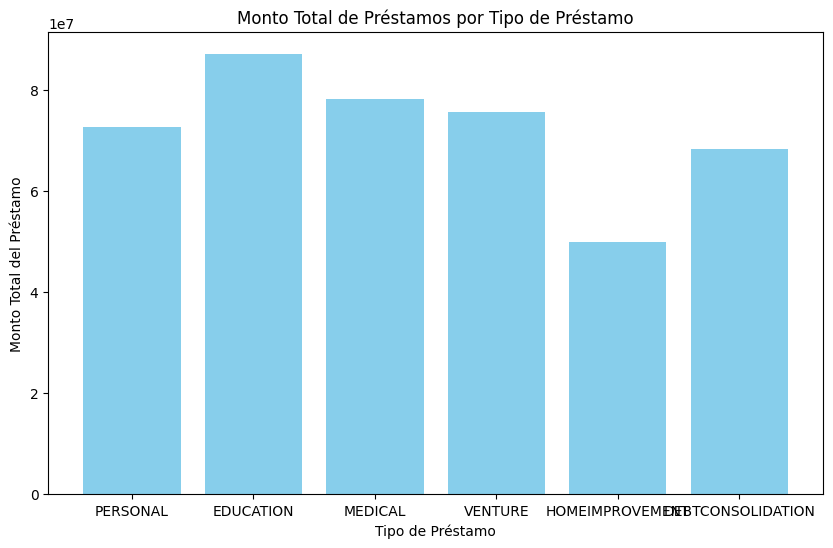

/var/folders/qk/vs0fpyhx3kz78hrbps32lmlw0000gn/T/ipykernel_31838/128753908.py:17: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(loan_int_rate, labels=loan_intent)


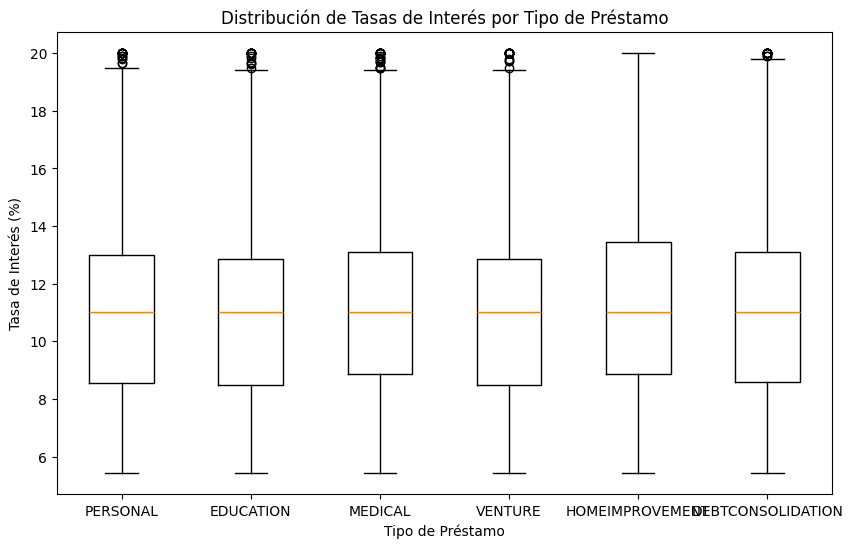

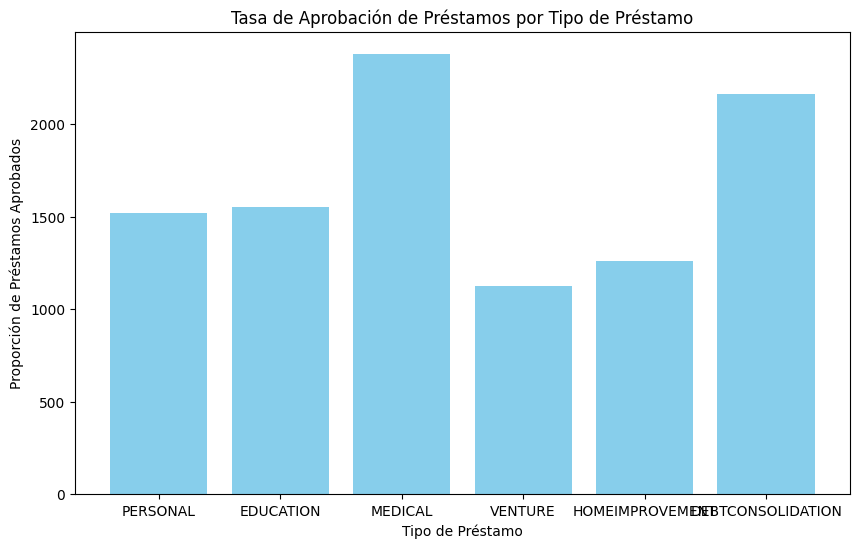

In [6]:

# Gráfico de Barras: loan_intent vs. loan_amnt
loan_intent = df['loan_intent'].unique()
loan_amnt = [df.loc[df['loan_intent'] == intent, 'loan_amnt'].sum() for intent in loan_intent]

plt.figure(figsize=(10,6))
plt.bar(loan_intent, loan_amnt, color='skyblue')
plt.title('Monto Total de Préstamos por Tipo de Préstamo')
plt.xlabel('Tipo de Préstamo')
plt.ylabel('Monto Total del Préstamo')
plt.show()

# Boxplot: loan_intent vs. loan_int_rate
loan_intent = df['loan_intent'].unique()
loan_int_rate = [df.loc[df['loan_intent'] == intent, 'loan_int_rate'] for intent in loan_intent]

plt.figure(figsize=(10,6))
plt.boxplot(loan_int_rate, labels=loan_intent)
plt.title('Distribución de Tasas de Interés por Tipo de Préstamo')
plt.xlabel('Tipo de Préstamo')
plt.ylabel('Tasa de Interés (%)')
plt.show()

# Gráfico de Barras: loan_intent vs. loan_status
loan_intent = df['loan_intent'].unique()
loan_status = [df.loc[df['loan_intent'] == intent, 'loan_status'].value_counts().index[1] for intent in loan_intent]
counts = [df.loc[df['loan_intent'] == intent, 'loan_status'].value_counts().values[1] for intent in loan_intent]

plt.figure(figsize=(10,6))
plt.bar(loan_intent, counts, color='skyblue')
plt.title('Tasa de Aprobación de Préstamos por Tipo de Préstamo')
plt.xlabel('Tipo de Préstamo')
plt.ylabel('Proporción de Préstamos Aprobados')
plt.show()

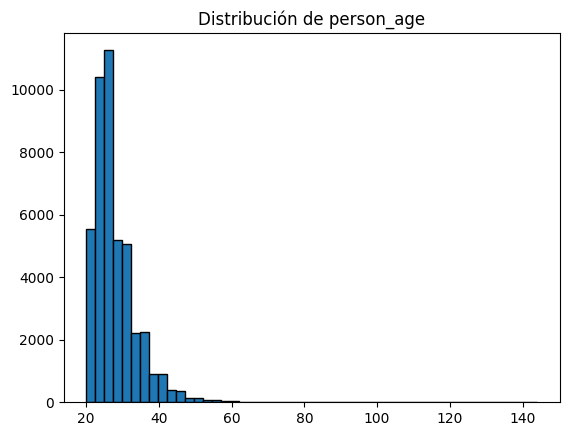

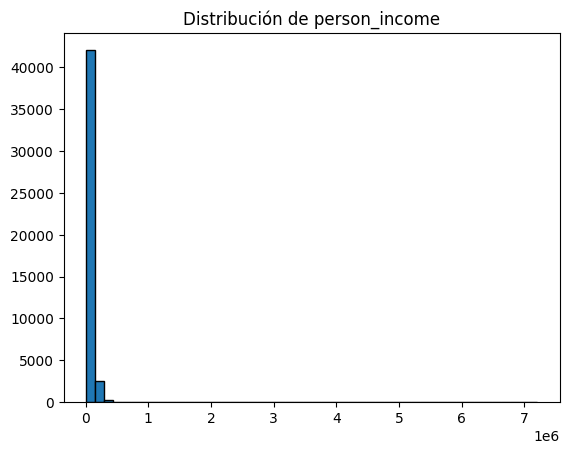

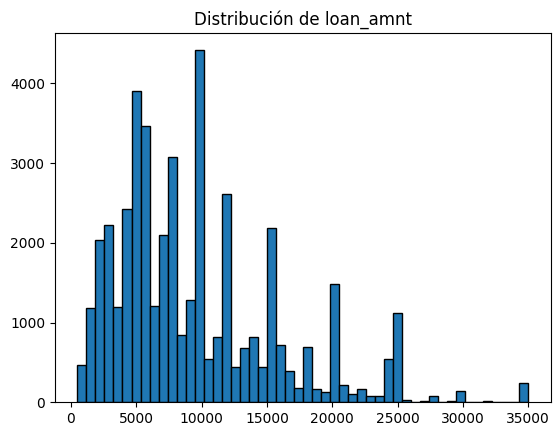

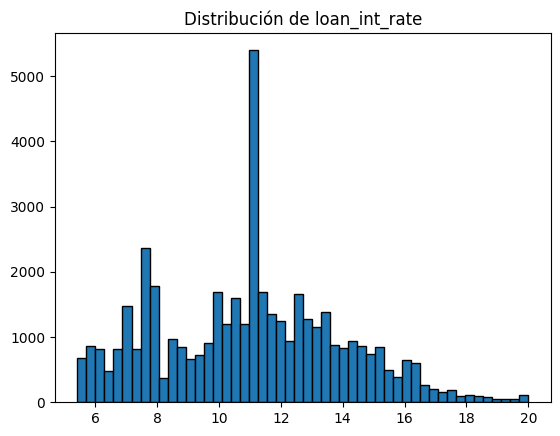

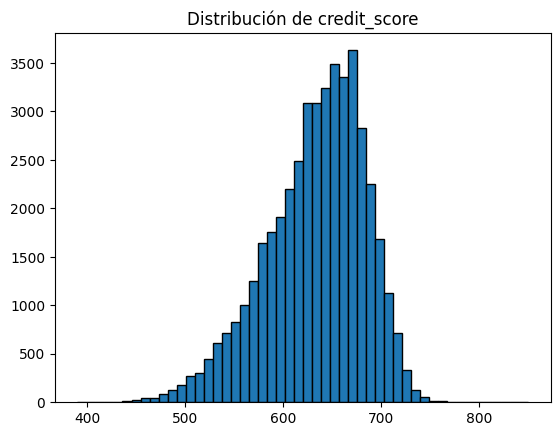

In [7]:
num_cols = ["person_age", "person_income", "loan_amnt", "loan_int_rate", "credit_score"]

for col in num_cols:
    plt.hist(df[col], bins=50, edgecolor='black')
    plt.title(f"Distribución de {col}")
    plt.show()

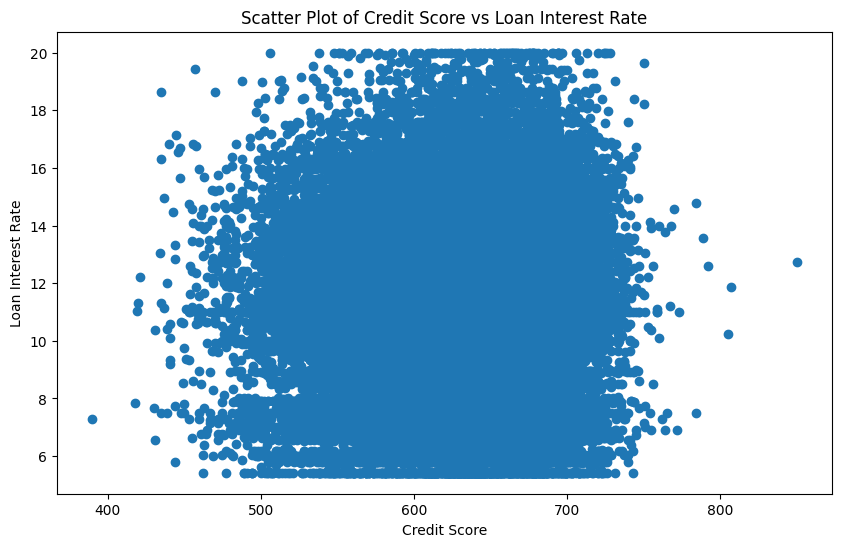

In [19]:
plt.figure(figsize=(10,6))
plt.scatter(df['credit_score'], df['loan_int_rate'])
plt.xlabel('Credit Score')
plt.ylabel('Loan Interest Rate')
plt.title('Scatter Plot of Credit Score vs Loan Interest Rate')
plt.show()

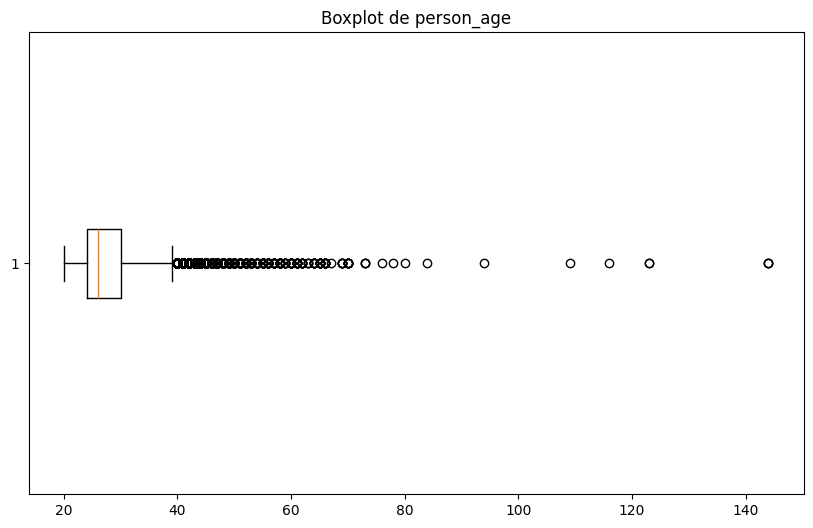

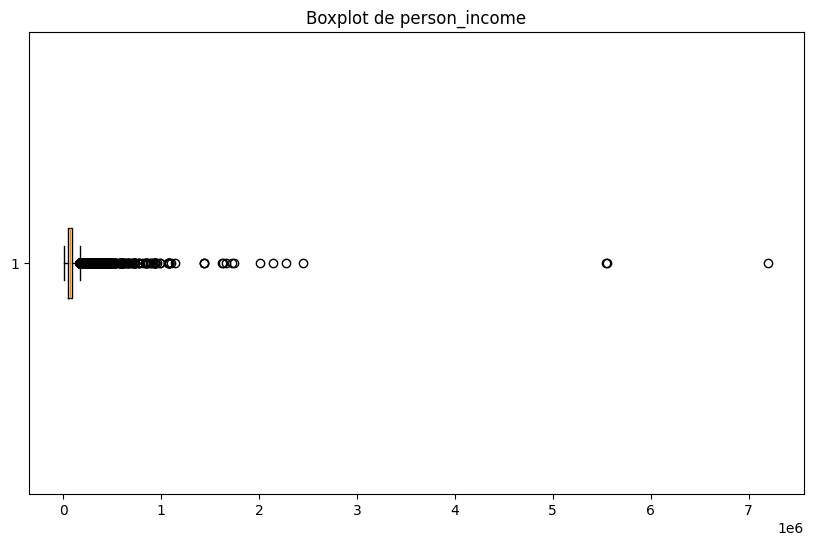

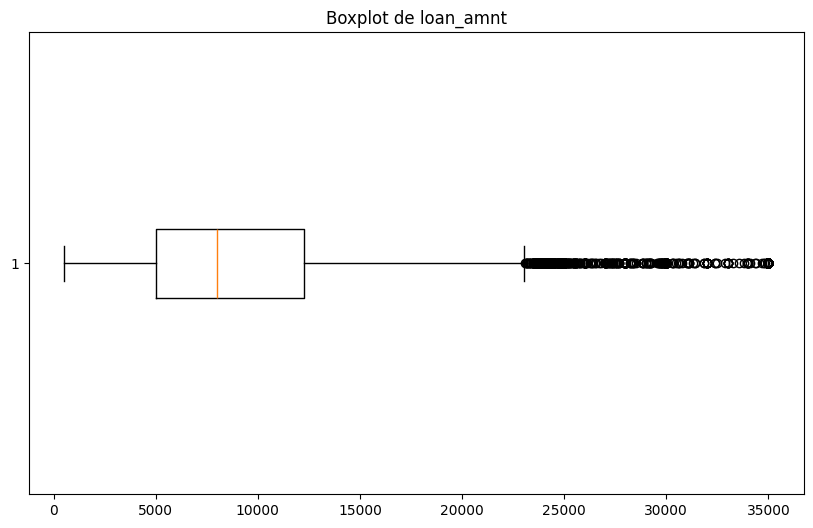

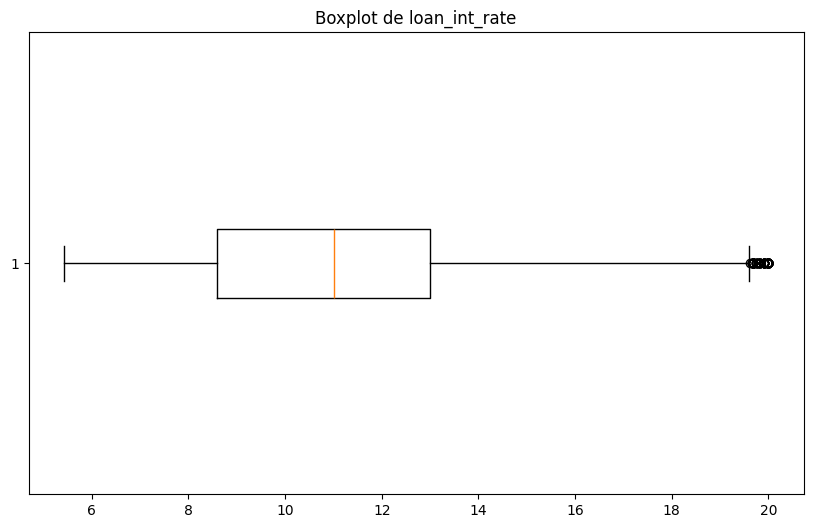

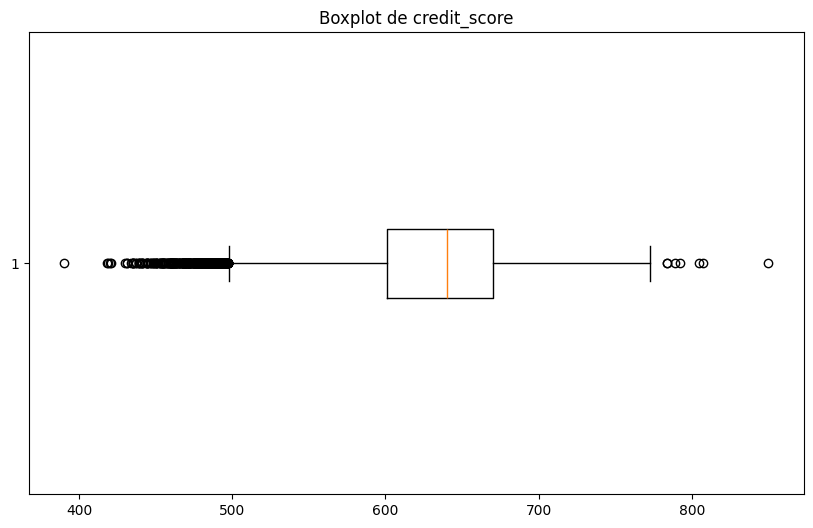

In [37]:
for col in num_cols:
    plt.figure(figsize=(10,6))
    plt.boxplot(df[col], vert=False)
    plt.title(f"Boxplot de {col}")
    plt.show()

In [38]:

corr = df[num_cols].corr()
corr.style.format(precision=2).background_gradient(cmap='coolwarm')

,person_age,person_income,loan_amnt,loan_int_rate,credit_score
person_age,1.00,0.19,0.05,0.01,0.18
person_income,0.19,1.00,0.24,0.00,0.04
loan_amnt,0.05,0.24,1.00,0.15,0.01
loan_int_rate,0.01,0.00,0.15,1.00,0.01
credit_score,0.18,0.04,0.01,0.01,1.00


In [39]:
# Seleccionar solo columnas numéricas
df_numeric = df.select_dtypes(include=["number"])

# Calcular la correlación con loan_status
correlation = df_numeric.corr()["loan_status"].sort_values(ascending=False)
print(correlation)


loan_status                   1.000000
loan_percent_income           0.384880
loan_int_rate                 0.332005
loan_amnt                     0.107714
credit_score                 -0.007647
cb_person_cred_hist_length   -0.014851
person_emp_exp               -0.020481
person_age                   -0.021476
person_income                -0.135808
Name: loan_status, dtype: float64


In [40]:
fig = px.box(df, x="person_gender", y="loan_int_rate", title="Tasa de Interés por Género")
fig.show()

fig = px.box(df, x="person_education", y="loan_int_rate", title="Tasa de Interés por Nivel Educativo")
fig.show()


In [41]:
fig = px.scatter(df, x="person_income", y="loan_percent_income", 
                 title="Relación entre Ingreso y % del Ingreso destinado al Préstamo", 
                 log_x=True, opacity=0.5)
fig.show()


In [42]:
fig = px.histogram(df, x="previous_loan_defaults_on_file", color="loan_status",
                   title="Impacto de Defaults Anteriores en el Estado del Préstamo", barmode="group")
fig.show()


In [43]:
dfparrallel = df[["person_gender","person_education","previous_loan_defaults_on_file","loan_status"]]
fig = px.parallel_categories(dfparrallel)

fig.show()

In [44]:
fig2 = px.violin(df, y="loan_amnt", x="loan_status", color="person_education", box=True, points="all",
          hover_data=df.columns)
fig2.show()

In [45]:

"""from ydata_profiling import ProfileReport

# Selección de columnas específicas
columns_to_profile = [
    "person_age", "person_income", "person_emp_exp", "loan_amnt", 
    "loan_int_rate", "loan_percent_income", "cb_person_cred_hist_length", 
    "credit_score", "previous_loan_defaults_on_file", "loan_status"
]

# Crear el reporte
profile = ProfileReport(df[columns_to_profile], title="Reporte de Perfil del Dataset")

# Exportar el reporte a un archivo HTML
profile.to_file("loan_data_profile_report.html")
"""


'from ydata_profiling import ProfileReport\n\n# Selección de columnas específicas\ncolumns_to_profile = [\n    "person_age", "person_income", "person_emp_exp", "loan_amnt", \n    "loan_int_rate", "loan_percent_income", "cb_person_cred_hist_length", \n    "credit_score", "previous_loan_defaults_on_file", "loan_status"\n]\n\n# Crear el reporte\nprofile = ProfileReport(df[columns_to_profile], title="Reporte de Perfil del Dataset")\n\n# Exportar el reporte a un archivo HTML\nprofile.to_file("loan_data_profile_report.html")\n'

### Eliminación de columnas problemáticas y creación de nuevas variables
#### En esta celda:

Eliminamos variables que podrían causar fuga de información, como:

loan_int_rate: refleja decisiones tomadas con base en el riesgo.

credit_score: puede ser un resumen de información previa.

loan_percent_income: derivada de otras variables, por lo que genera redundancia.

Creamos nuevas variables (feature engineering) para enriquecer el modelo:

loan_to_income_ratio: mide la carga del préstamo relativo a los ingresos.

log_income: transforma ingresos para reducir el efecto de outliers.

income_per_year_of_exp: ingresos ajustados por experiencia laboral.

is_young: indicador binario para identificar perfiles jóvenes (< 25 años), potencialmente más riesgosos.

Este paso mejora la representatividad de los datos y ayuda al modelo a aprender relaciones más sólidas.



In [45]:
# Eliminar columnas que pueden generar fuga de información
cols_to_drop = ['loan_int_rate', 'credit_score', 'loan_percent_income']
df.drop(columns=cols_to_drop, inplace=True)


# Reemplazo de ceros para evitar división por cero
df['person_emp_exp'] = df['person_emp_exp'].replace(0, 0.1)

# Crear nuevas features
df['loan_to_income_ratio'] = df['loan_amnt'] / (df['person_income'] + 1)
df['log_income'] = np.log1p(df['person_income'])
df['income_per_year_of_exp'] = df['person_income'] / df['person_emp_exp']
df['is_young'] = (df['person_age'] < 25).astype(int)


Las siguientes variables tienen una cantidad significativa de valores atípicos:

person_age (2188 outliers) → Posibles edades extremas.
person_income (2218 outliers) → Ingresos anormalmente altos o bajos.
person_emp_exp (1724 outliers) → Experiencia laboral con valores atípicos.
loan_amnt (2348 outliers) → Monto del préstamo con valores extremos.
loan_int_rate (124 outliers) → Tasas de interés fuera del rango esperado.
loan_percent_income (744 outliers) → Proporción de préstamo sobre ingresos con valores inusuales.
cb_person_cred_hist_length (1366 outliers) → Longitud del historial crediticio con valores extremos.
credit_score (467 outliers) → Puntajes crediticios inusuales.
loan_status (10,000 outliers) → Parece ser la variable objetivo (no se debe tratar como outlier).
Estrategia de Tratamiento
Podemos manejar los outliers de varias maneras:

Winsorización para person_age, person_income, loan_amnt, loan_percent_income y cb_person_cred_hist_length para limitar los valores a percentiles 1% y 99%.
Transformación Logarítmica en person_income y loan_amnt si la distribución está muy sesgada.
Mantener sin cambios la variable loan_status ya que es nuestra variable objetivo.

In [46]:
from scipy.stats.mstats import winsorize

# Columnas a winsorizar
cols_to_winsor = [
    'person_income',
    'loan_amnt',
    'income_per_year_of_exp',
    'loan_to_income_ratio'
]

# Aplicar winsorización
for col in cols_to_winsor:
    df[col] = winsorize(df[col], limits=[0.01, 0.01])



### 📘 Paso 4: Codificación y división en entrenamiento y prueba

En este paso:
- Se codifican las variables categóricas:
  - `person_education` como variable ordinal.
  - `person_gender` y `previous_loan_defaults_on_file` como binarias.
  - `person_home_ownership` y `loan_intent` mediante one-hot encoding (sin multicolinealidad).
- Se separa la variable objetivo (`loan_status`).
- Se divide el conjunto en entrenamiento (80%) y prueba (20%), manteniendo la proporción de clases con `stratify=y`.

Esto deja los datos listos para el modelado.

✅ Codificación Binaria:

person_gender: (0 = female, 1 = male)
previous_loan_defaults_on_file: (0 = No, 1 = Yes)
✅ Conversión Ordinal:

person_education: (High School = 1, Associate = 2, Bachelor = 3, Master = 4, Doctorate = 5)
✅ One-Hot Encoding:

person_home_ownership: (home_ownership_MORTGAGE, home_ownership_OTHER, home_ownership_OWN, home_ownership_RENT)
loan_intent: (loan_intent_DEBTCONSOLIDATION, loan_intent_EDUCATION, loan_intent_HOMEIMPROVEMENT, loan_intent_MEDICAL, loan_intent_PERSONAL, loan_intent_VENTURE)


In [47]:
from sklearn.model_selection import train_test_split

# Codificación de variables categóricas
education_map = {'High School': 1, 'Associate': 2, 'Bachelor': 3, 'Master': 4, 'Doctorate': 5}
df['person_education'] = df['person_education'].map(education_map)
df['person_gender'] = df['person_gender'].map({'female': 0, 'male': 1})
df['previous_loan_defaults_on_file'] = df['previous_loan_defaults_on_file'].map({'No': 0, 'Yes': 1})

# One-hot encoding para variables nominales
df = pd.get_dummies(df, columns=['person_home_ownership', 'loan_intent'], drop_first=True)


In [48]:
df = df[df['previous_loan_defaults_on_file'] == 1]

In [53]:


X = df_sin_default.drop(columns=["loan_status"])
y = df_sin_default["loan_status"]

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, stratify=y, random_state=42
)



#### Desbalance de clases se la ponderara de clases en el modelo

### Modelo Base, regresion logistica con class weight balanced

In [54]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report

# Entrenar regresión logística con ajuste de clases
logreg = LogisticRegression(class_weight='balanced', solver='liblinear', max_iter=1000, random_state=42)
logreg.fit(X_train, y_train)

# Predicciones y evaluación
y_pred = logreg.predict(X_test)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.88      0.63      0.74      7000
           1       0.36      0.71      0.47      2000

    accuracy                           0.65      9000
   macro avg       0.62      0.67      0.61      9000
weighted avg       0.77      0.65      0.68      9000



### Modelo XGBoost con ajuste de desbalance (`scale_pos_weight`)

En esta celda se entrena un modelo XGBoost, que tiende a superar modelos lineales en tareas no lineales como el riesgo crediticio.

Se aplica el parámetro `scale_pos_weight`


In [55]:
from xgboost import XGBClassifier
from sklearn.metrics import classification_report

# Calcular el peso entre clases
scale_pos_weight = y_train.value_counts()[0] / y_train.value_counts()[1]
print(f"scale_pos_weight: {scale_pos_weight:.2f}")

# Entrenar el modelo XGBoost con ajuste de peso
xgb_model = XGBClassifier(
    scale_pos_weight=scale_pos_weight,
    n_estimators=200,
    max_depth=4,
    learning_rate=0.1,
    subsample=0.8,
    colsample_bytree=0.8,
    use_label_encoder=False,
    eval_metric='logloss',
    random_state=42
)

xgb_model.fit(X_train, y_train)

# Predicciones y evaluación
y_pred_xgb = xgb_model.predict(X_test)
print(classification_report(y_test, y_pred_xgb))


scale_pos_weight: 3.50


/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:22:34] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


              precision    recall  f1-score   support

           0       0.92      0.87      0.89      7000
           1       0.62      0.72      0.67      2000

    accuracy                           0.84      9000
   macro avg       0.77      0.80      0.78      9000
weighted avg       0.85      0.84      0.84      9000



###  Ajuste de hiperparámetros con RandomizedSearchCV

Se realiza una búsqueda aleatoria de combinaciones de hiperparámetros para el modelo XGBoost, enfocada en optimizar el `f1-score`.

Parámetros ajustados:
- `n_estimators`: número de árboles
- `max_depth`: profundidad máxima de cada árbol
- `learning_rate`: tasa de aprendizaje
- `subsample`: fracción de muestras utilizadas por árbol
- `colsample_bytree`: fracción de features por árbol

Se mantiene `scale_pos_weight` para el desbalance. El modelo resultante será evaluado con las mismas métricas y se comparará con el modelo base anterior.


In [57]:
from sklearn.model_selection import RandomizedSearchCV
from xgboost import XGBClassifier

# Recalcular scale_pos_weight
scale_pos_weight = y_train.value_counts()[0] / y_train.value_counts()[1]

# Definir modelo base
xgb_base = XGBClassifier(
    scale_pos_weight=scale_pos_weight,
    use_label_encoder=False,
    eval_metric='logloss',
    random_state=42
)

# Espacio de búsqueda reducido para rapidez
param_dist = {
    'n_estimators': [300, 350, 400],
    'max_depth': [3, 4, 5, 6],
    'learning_rate': [0.1, 0.15, 0.2],
    'subsample': [0.7, 0.8, 0.9],
    'colsample_bytree': [0.7, 0.8, 0.9]
}

# Randomized Search con validación cruzada
random_search = RandomizedSearchCV(
    estimator=xgb_base,
    param_distributions=param_dist,
    n_iter=10,
    scoring='f1',
    cv=3,
    verbose=2,
    n_jobs=-1,
    random_state=42
)

random_search.fit(X_train, y_train)

# Mejor modelo encontrado
best_xgb = random_search.best_estimator_
print("Mejores hiperparámetros encontrados:")
print(random_search.best_params_)

# Evaluar en test
from sklearn.metrics import classification_report
y_pred_best = best_xgb.predict(X_test)
print(classification_report(y_test, y_pred_best))


Fitting 3 folds for each of 10 candidates, totalling 30 fits


/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:08] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:08] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:08] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:08] WARNING: /Users/runner/work/xgboost

[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.7; total time=   3.7s


/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:12] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=400, subsample=0.7; total time=   6.9s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=400, subsample=0.7; total time=   7.0s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=400, subsample=0.7; total time=   7.0s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.7; total time=   3.5s


/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:15] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:15] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:15] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:15] WARNING: /Users/runner/work/xgboost

[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=3, n_estimators=300, subsample=0.7; total time=   3.3s


/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:18] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=6, n_estimators=300, subsample=0.9; total time=   6.1s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=6, n_estimators=300, subsample=0.9; total time=   6.3s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=6, n_estimators=300, subsample=0.9; total time=   6.2s


/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:21] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:21] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:22] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.7, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.7; total time=   4.9s


/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:23] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.2, max_depth=3, n_estimators=300, subsample=0.7; total time=   3.7s
[CV] END colsample_bytree=0.7, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.7; total time=   4.5s


/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:25] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.7, learning_rate=0.1, max_depth=4, n_estimators=300, subsample=0.7; total time=   4.5s


/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:26] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:26] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.2, max_depth=3, n_estimators=300, subsample=0.7; total time=   3.7s


/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:27] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.2, max_depth=3, n_estimators=300, subsample=0.7; total time=   3.7s


/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:29] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.7; total time=   5.2s
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.7; total time=   5.2s


/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:31] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:31] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=300, subsample=0.7; total time=   4.7s


/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:32] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.9, learning_rate=0.1, max_depth=3, n_estimators=350, subsample=0.7; total time=   4.3s


/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:33] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.9, learning_rate=0.1, max_depth=3, n_estimators=350, subsample=0.7; total time=   4.5s
[CV] END colsample_bytree=0.9, learning_rate=0.1, max_depth=3, n_estimators=350, subsample=0.7; total time=   4.5s


/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:35] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:35] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.2, max_depth=4, n_estimators=400, subsample=0.8; total time=   5.4s


/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:37] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.2, max_depth=4, n_estimators=400, subsample=0.8; total time=   5.0s


/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:38] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.9, learning_rate=0.15, max_depth=4, n_estimators=350, subsample=0.9; total time=   4.4s


/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:40] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.8, learning_rate=0.2, max_depth=4, n_estimators=400, subsample=0.8; total time=   4.9s


/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:41] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.9, learning_rate=0.15, max_depth=4, n_estimators=350, subsample=0.9; total time=   4.7s


/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:42] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[CV] END colsample_bytree=0.9, learning_rate=0.15, max_depth=4, n_estimators=350, subsample=0.9; total time=   4.5s
[CV] END colsample_bytree=0.8, learning_rate=0.15, max_depth=3, n_estimators=300, subsample=0.7; total time=   2.9s
[CV] END colsample_bytree=0.8, learning_rate=0.15, max_depth=3, n_estimators=300, subsample=0.7; total time=   2.6s
[CV] END colsample_bytree=0.8, learning_rate=0.15, max_depth=3, n_estimators=300, subsample=0.7; total time=   1.8s


/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:25:44] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


Mejores hiperparámetros encontrados:
{'subsample': 0.9, 'n_estimators': 300, 'max_depth': 6, 'learning_rate': 0.1, 'colsample_bytree': 0.8}
              precision    recall  f1-score   support

           0       0.92      0.89      0.91      7000
           1       0.66      0.73      0.69      2000

    accuracy                           0.86      9000
   macro avg       0.79      0.81      0.80      9000
weighted avg       0.86      0.86      0.86      9000



### 📘 Paso 8: Entrenamiento de Random Forest con ajuste de clases

Se entrena un modelo Random Forest con `class_weight='balanced'` para abordar el desbalance de clases, de forma similar a como se trató en XGBoost.

Parámetros usados:
- `n_estimators=200`: número de árboles.
- `max_depth=10`: para limitar sobreajuste.
- `n_jobs=-1`: uso de todos los núcleos disponibles.

Se evalúa con las mismas métricas de clasificación, poniendo énfasis en el rendimiento sobre la clase 1 (riesgo de incumplimiento).


In [58]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report

# Entrenar modelo base de Random Forest
rf_model = RandomForestClassifier(
    n_estimators=200,
    max_depth=10,
    class_weight='balanced',
    random_state=42,
    n_jobs=-1
)

rf_model.fit(X_train, y_train)

# Evaluar en test
y_pred_rf = rf_model.predict(X_test)
print(classification_report(y_test, y_pred_rf))


              precision    recall  f1-score   support

           0       0.90      0.92      0.91      7000
           1       0.69      0.63      0.66      2000

    accuracy                           0.85      9000
   macro avg       0.79      0.77      0.78      9000
weighted avg       0.85      0.85      0.85      9000



### Entrenamiento de Red Neuronal Simple (Keras)

Se construye una red neuronal básica para comparar su desempeño con los modelos previos. Características:
- Dos capas densas con activación ReLU.
- Dropout del 30% para evitar sobreajuste.
- Función de pérdida binaria y métrica de recall.
- Manejo del desbalance con `class_weight`.

La red se entrena por 20 épocas con early stopping manual (si se desea) y se evalúa con las métricas estándar, prestando atención a la clase 1.


In [22]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy
from sklearn.metrics import classification_report

# Calcular pesos de clase para balanceo
from sklearn.utils.class_weight import compute_class_weight

class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.unique(y_train),
    y=y_train
)
class_weight_dict = dict(enumerate(class_weights))
print("Pesos de clase:", class_weight_dict)

# Construcción del modelo
model = Sequential([
    Dense(64, activation='relu', input_shape=(X_train.shape[1],)),
    Dropout(0.3),
    Dense(32, activation='relu'),
    Dropout(0.3),
    Dense(1, activation='sigmoid')
])

model.compile(
    optimizer=Adam(learning_rate=0.001),
    loss=BinaryCrossentropy(),
    metrics=['Precision', 'Recall']
)

# Entrenamiento
history = model.fit(
    X_train, y_train,
    epochs=20,
    batch_size=64,
    validation_split=0.2,
    class_weight=class_weight_dict,
    verbose=1
)

# Evaluación en test
y_pred_nn = (model.predict(X_test) > 0.5).astype("int32")
print(classification_report(y_test, y_pred_nn))


2025-03-29 13:07:35.384238: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


Pesos de clase: {0: 0.6428571428571429, 1: 2.25}


/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/20
450/450 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - Precision: 0.2345 - Recall: 0.4653 - loss: 2583.3018 - val_Precision: 0.2358 - val_Recall: 0.5117 - val_loss: 0.6404
Epoch 2/20
450/450 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - Precision: 0.2313 - Recall: 0.6857 - loss: 48.1173 - val_Precision: 0.2250 - val_Recall: 1.0000 - val_loss: 0.7403
Epoch 3/20
450/450 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - Precision: 0.2259 - Recall: 0.7541 - loss: 15.7036 - val_Precision: 0.2250 - val_Recall: 1.0000 - val_loss: 0.7325
Epoch 4/20
450/450 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - Precision: 0.2249 - Recall: 0.8474 - loss: 6.3926 - val_Precision: 0.2250 - val_Recall: 1.0000 - val_loss: 0.7201
Epoch 5/20
450/450 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - Precision: 0.2206 - Recall: 0.8785 - loss: 2.6164 - val_Precision: 0.2250 - val_Recall: 1.0000 - val_loss: 0.7041
Epoch 6/20
450/450 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - Precision: 0.2192 - Recall: 0.9282 - loss: 1.4103 - val_Precision: 0.2250 - val_Recall: 1.0000 - val_

/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this beh

📘 Paso 10: Curva ROC-AUC comparando modelos

Se genera la curva ROC y se calcula el AUC para los modelos entrenados:

- **XGBoost optimizado**
- **Random Forest**
- **Regresión Logística**

El AUC (Área Bajo la Curva) mide la capacidad del modelo para distinguir entre incumplidores y no incumplidores. Cuanto más cerca esté de 1, mejor.

Este gráfico permite comparar visualmente qué modelo ofrece mejor rendimiento discriminativo. El mejor modelo será el que tenga mayor área bajo la curva (AUC).


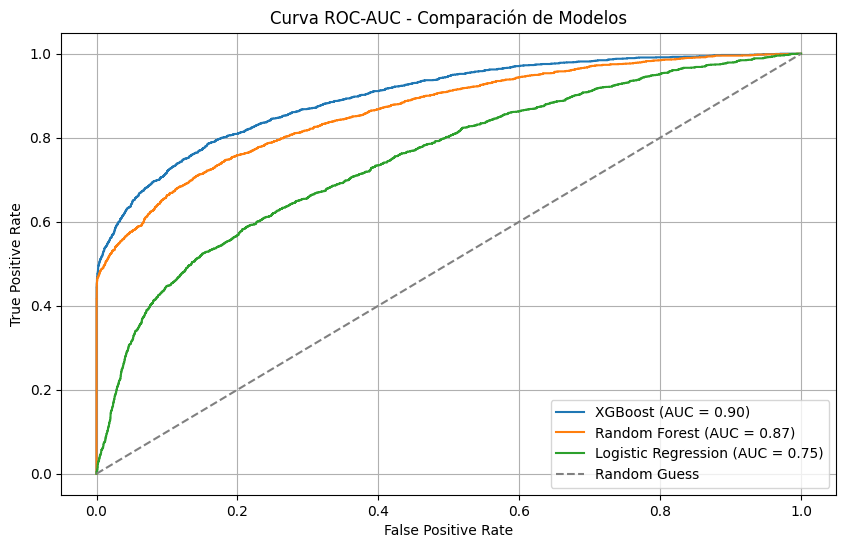

In [59]:
from sklearn.metrics import roc_curve, roc_auc_score
import matplotlib.pyplot as plt

# Probabilidades para cada modelo
y_proba_xgb = best_xgb.predict_proba(X_test)[:, 1]
y_proba_rf = rf_model.predict_proba(X_test)[:, 1]
y_proba_logreg = logreg.predict_proba(X_test)[:, 1]

# Calcular AUC
auc_xgb = roc_auc_score(y_test, y_proba_xgb)
auc_rf = roc_auc_score(y_test, y_proba_rf)
auc_logreg = roc_auc_score(y_test, y_proba_logreg)

# Calcular FPR, TPR para curva ROC
fpr_xgb, tpr_xgb, _ = roc_curve(y_test, y_proba_xgb)
fpr_rf, tpr_rf, _ = roc_curve(y_test, y_proba_rf)
fpr_logreg, tpr_logreg, _ = roc_curve(y_test, y_proba_logreg)

# Gráfico
plt.figure(figsize=(10, 6))
plt.plot(fpr_xgb, tpr_xgb, label=f'XGBoost (AUC = {auc_xgb:.2f})')
plt.plot(fpr_rf, tpr_rf, label=f'Random Forest (AUC = {auc_rf:.2f})')
plt.plot(fpr_logreg, tpr_logreg, label=f'Logistic Regression (AUC = {auc_logreg:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', color='gray', label='Random Guess')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Curva ROC-AUC - Comparación de Modelos')
plt.legend()
plt.grid(True)
plt.show()


Analisis de over/underfitting

In [64]:
from sklearn.metrics import classification_report, roc_auc_score

# Predicciones
y_train_pred = best_xgb.predict(X_train)
y_test_pred = best_xgb.predict(X_test)

y_train_proba = best_xgb.predict_proba(X_train)[:, 1]
y_test_proba = best_xgb.predict_proba(X_test)[:, 1]

# Reportes
print("🔹 MÉTRICAS ENTRENAMIENTO:")
print(classification_report(y_train, y_train_pred))
print("AUC ROC Train:", roc_auc_score(y_train, y_train_proba))

print("\n🔹 MÉTRICAS PRUEBA:")
print(classification_report(y_test, y_test_pred))
print("AUC ROC Test:", roc_auc_score(y_test, y_test_proba))


🔹 MÉTRICAS ENTRENAMIENTO:
              precision    recall  f1-score   support

           0       0.97      0.92      0.94     28000
           1       0.77      0.89      0.82      8000

    accuracy                           0.92     36000
   macro avg       0.87      0.90      0.88     36000
weighted avg       0.92      0.92      0.92     36000

AUC ROC Train: 0.9719643772321427

🔹 MÉTRICAS PRUEBA:
              precision    recall  f1-score   support

           0       0.92      0.89      0.91      7000
           1       0.66      0.73      0.69      2000

    accuracy                           0.86      9000
   macro avg       0.79      0.81      0.80      9000
weighted avg       0.86      0.86      0.86      9000

AUC ROC Test: 0.8979085357142856


/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:51:43] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:51:50] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:51:53] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:51:57] WARNING: /Users/runner/work/xgboost

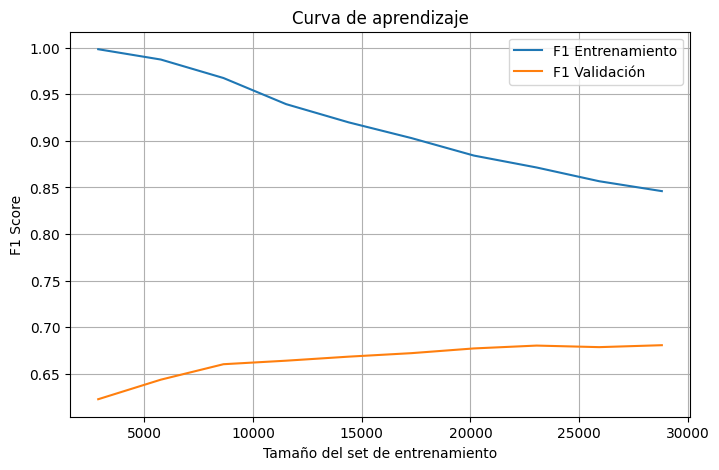

In [65]:
from sklearn.model_selection import learning_curve
import matplotlib.pyplot as plt
import numpy as np

train_sizes, train_scores, test_scores = learning_curve(
    best_xgb, X_train, y_train, cv=5, scoring='f1',
    train_sizes=np.linspace(0.1, 1.0, 10), random_state=42
)

train_mean = np.mean(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)

plt.figure(figsize=(8, 5))
plt.plot(train_sizes, train_mean, label="F1 Entrenamiento")
plt.plot(train_sizes, test_mean, label="F1 Validación")
plt.xlabel("Tamaño del set de entrenamiento")
plt.ylabel("F1 Score")
plt.title("Curva de aprendizaje")
plt.legend()
plt.grid(True)
plt.show()


In [66]:
from sklearn.model_selection import cross_val_score

scores = cross_val_score(best_xgb, X_train, y_train, cv=5, scoring='f1')
print("F1 promedio cross-validation:", scores.mean())


/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:54:43] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:54:48] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:54:51] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:54:55] WARNING: /Users/runner/work/xgboost

F1 promedio cross-validation: 0.6808654080651522


In [60]:
# Validar tipos
print(X_train.dtypes)

# Asegurarse que no hay columnas no numéricas
X_train = X_train.astype(float)

# Reentrenar modelo
best_xgb.fit(X_train, y_train)


person_age                     float64
person_gender                    int64
person_education                 int64
person_income                  float64
person_emp_exp                 float64
loan_amnt                      float64
cb_person_cred_hist_length     float64
loan_to_income_ratio           float64
log_income                     float64
income_per_year_of_exp         float64
is_young                         int64
person_home_ownership_OTHER       bool
person_home_ownership_OWN         bool
person_home_ownership_RENT        bool
loan_intent_EDUCATION             bool
loan_intent_HOMEIMPROVEMENT       bool
loan_intent_MEDICAL               bool
loan_intent_PERSONAL              bool
loan_intent_VENTURE               bool
dtype: object


/usr/local/Caskroom/miniconda/base/envs/visualizacion/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [08:27:27] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.8, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric='logloss',
              feature_types=None, gamma=None, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=0.1, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=6,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=300,
              n_jobs=None, num_parallel_tree=None, random_state=42, ...)

100%|===================| 35994/36000 [15:37<00:00]        

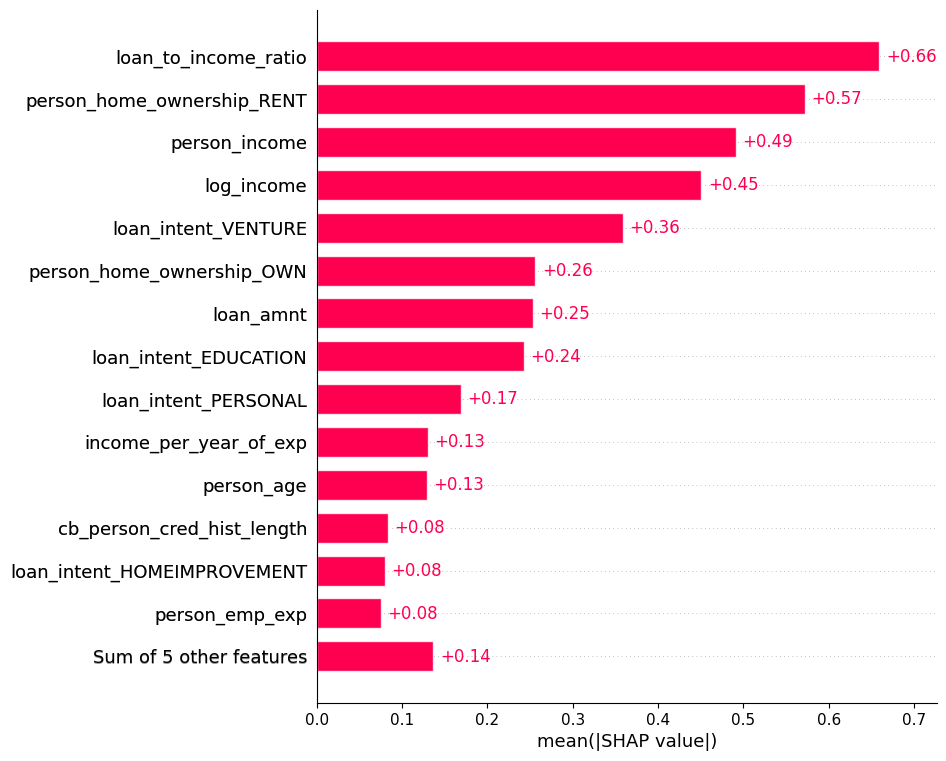

In [61]:
import shap

# Crear el explainer para XGBoost
explainer = shap.Explainer(best_xgb, X_train)

# Calcular los valores SHAP
shap_values = explainer(X_train, check_additivity=False)

# Gráfico de importancia de variables (bar plot)
shap.plots.bar(shap_values, max_display=15)


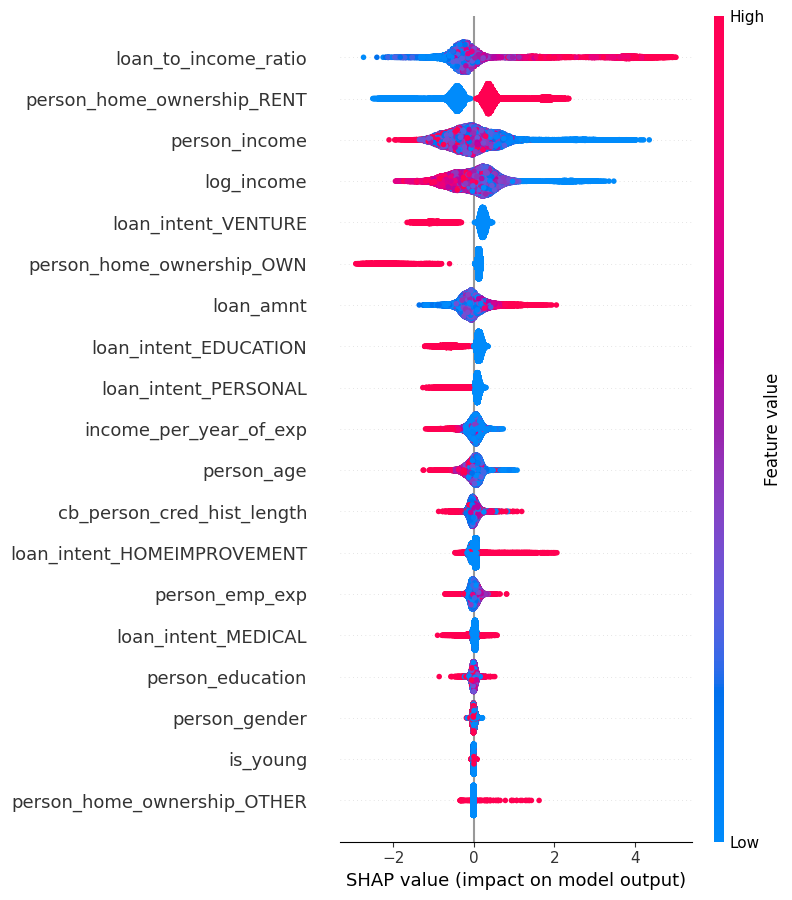

In [62]:
shap.summary_plot(shap_values, X_train)


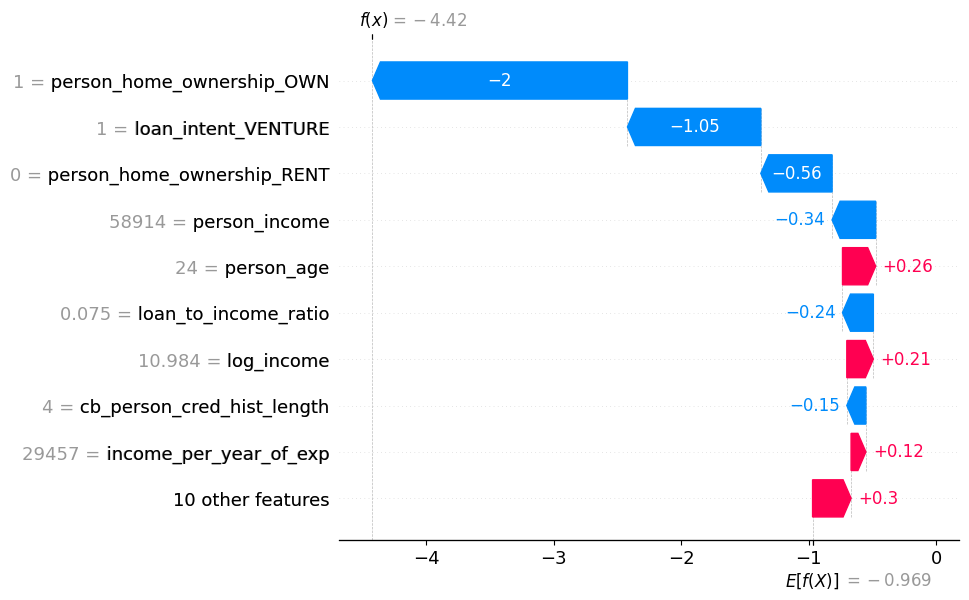

In [63]:
# Visualizar contribución de cada variable en una observación puntual
shap.plots.waterfall(shap_values[0])


In [67]:
import pickle

with open("xgb_model_credit_risk.pkl", "wb") as f:
    pickle.dump(best_xgb, f)


In [71]:
!git add . 
!git commit -m "commit message" 
!git push origin main --force

On branch main
Your branch is up to date with 'origin/main'.

nothing to commit, working tree clean
Everything up-to-date
